# Planning stage (individual)

We will be using this dataset:

https://www.kaggle.com/datasets/tawfikelmetwally/employee-dataset 

This is a sample dataset that includes data for employees in a company, notably their qualifications, time of joining, location, salary tiers, age, gender, if they have been without assigned work, experience, and a target column of whether they have left.

The data is anonymized, it is real data that has been provided by someone with access to a company's HR data, however all the staff and the company is unknown for privacy reasons.

There is missing context for some of the columns, notably salary tiers, where it is not known what each tier means, although there is speculation from users of the dataset that a higher tier means more pay, it is not confirmed whether it is true or false.

This dataset is a csv file with a size of 195.25kB, it contains 9 columns (mentioned above), and has 4653 entries (rows).

### We will now begin an analysis on each column:

Education: The educational qualification of each employee
    This column is categorical and has __NO__ null values, and consists of 3 unique values being: 'Bachelors', 'Masters', 'PHD'
    The most common input is Bachelors, followed by Masters, then PHD

JoiningYear: The year each employee joined the company
    This column is numerical and has __NO__ null values, it values are within a range, including the limits of 2012 and 2018.
    The most common values are 2017, 2015, 2014, 2013, 2016, 2012, 2018

City: The location where each employee resides
    This column is categorical, and has __NO__ null values, it consists of 3 unique values: 'Bangalore', 'Pune', 'New Delhi'
    The most common input is angalore, followed by Pune, and finally New Delhi.

PaymentTier: Categorization of employees into different salary tiers
    This column is numerical, and has __NO__ null values, it ranges from 1-3 inclusive, with the most common input being 3, 2, and then 1.
    The meaning of the numbers is unknown, however there is speculation from previous users of the datset that a higher tier links with a greater salary amount.

Age: the age of each employee
    This column is numerical, and has __NO__ null values, it ranges from 22-41 inclusive.
    The mean age is 29.4, with a standard deviation of 4.83.

Gender: the gender identity of each employee
    Although this only has 2 unique values, this column is not binary, but categorical, and only contains two unique values: 'Male', 'Female'
    The most common value is Male

EverBenched: Indicates whether the employee has ever been without assigned work
    This is a binary column, with __NO__ null values, with only true or false categories.
    The most common input is false, at about 90%

ExperienceInCurrentDomain: number of years experience each employee has in their respective field
    This is a numerical column with __NO__ null values, its values range between 0 and 7 inclusive.
    The mean is 2.91, with a standard deviation of 1.56, the most common value is 2 years.

LeaveOrNot: this is the target column, of whether or not the employee has left or is leaving the company
    This is a binary column, with __NO__ null values, __it is assumed that 1 represents an employee that has left the company, while 0 represents one that has not__.
    0 is the more common value, with the column having a mean of 0.34, and a std deviation of about 0.47.

### the question

We will be using LeaveOrNot as our target variable, the question we will be using for this first stage of exploratory data analysis is:

What causes employees to want to leave the company, and how could we predict this accurately?

### we will now conduct exploratory investigation

first we will be importing the libraries needed

In [1]:
library(tidyverse)
library(glmnet)
library(broom)
library(leaps)
library(repr)
library(faraway)
library(mltools)
library(modelr)
library(cowplot)
library(dplyr)
library(tibble)
library(ggplot2)
library(GGally)

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.5.1     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.1
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
Loading required package: Matrix


Attaching package: ‘Matrix’


The following objects are masked from ‘package:tidyr’:

    expand, pack, unpack


Loaded glmnet 4.1-8


Attaching package: ‘mltools’


The following object is masked from ‘package:tidyr’:

    replace_na



Attaching package: ‘modelr’


The following objects are masked from ‘package:mltools’:

    mse, rmse


The following object is masked from ‘package:broom’:

    bootstrap



Attaching package: ‘cowplot’

In [2]:
#loading the dataset into R, and confirming it is indeed loaded
Employee_df <- read.csv('Employee.csv')
dim(Employee_df)
head(Employee_df)

[1] 4653    9

,Education,JoiningYear,City,PaymentTier,Age,Gender,EverBenched,ExperienceInCurrentDomain,LeaveOrNot
,<chr>,<int>,<chr>,<int>,<int>,<chr>,<chr>,<int>,<int>
1,Bachelors,2017,Bangalore,3,34,Male,No,0,0
2,Bachelors,2013,Pune,1,28,Female,No,3,1
3,Bachelors,2014,New Delhi,3,38,Female,No,2,0
4,Masters,2016,Bangalore,3,27,Male,No,5,1
5,Masters,2017,Pune,3,24,Male,Yes,2,1
6,Bachelors,2016,Bangalore,3,22,Male,No,0,0


We can see that the dataset is properly loaded, all 4653 rows and 9 columns are loaded in, and it displays fine.

In [3]:
#we will now confirm that there are no missing values in any of the columns
#this function returns the name of any columns that have any null values in them
names(data)[colSums(is.na(Employee_df)) >0]

NULL

We can conclude that there is indeed no null values, and start our exploration.

In [4]:
#lets first get the summary of each numerical column
Employee_long_num <- Employee_df %>%
    select(-LeaveOrNot, -Education, -City, -Gender, -EverBenched, -PaymentTier) %>%
    gather(factor_key=TRUE, key = 'variable')

Employee_stats_num <- Employee_long_num %>%
    group_by(variable) %>%
    summarise(mean = mean(value), 
              sd = sd(value),  
              min = min(value),
              max = max(value))
head(Employee_stats_num)

variable,mean,sd,min,max
<fct>,<dbl>,<dbl>,<int>,<int>
JoiningYear,2015.062970,1.863377,2012,2018
Age,29.393295,4.826087,22,41
ExperienceInCurrentDomain,2.905652,1.558240,0,7


In [5]:
#now lets get the summary of each categorical column
Employee_long_cat <- Employee_df %>%
    select(Education, City, Gender, EverBenched, PaymentTier) %>%
    gather(factor_key=TRUE, key = 'variable')

Employee_stats_cat <- Employee_long_cat %>%
    group_by(variable) %>%
    summarise(unique_val = paste(unique(value), collapse = ',  '), 
              unique_num = length(unique(value)),  
              most = names(which.max(table(value))),
              most_prop = max(table(value))/length(value))
Employee_stats_cat

variable,unique_val,unique_num,most,most_prop
<fct>,<chr>,<int>,<chr>,<dbl>
Education,"Bachelors, Masters, PHD",3,Bachelors,0.7739093
City,"Bangalore, Pune, New Delhi",3,Bangalore,0.4788309
Gender,"Male, Female",2,Male,0.5970342
EverBenched,"No, Yes",2,No,0.8972706
PaymentTier,"3, 1, 2",3,3,0.7504836


We can see a brief description of the dataframe, both numerical and categorical, with the exception of the target variable that we will be predicting.

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwid

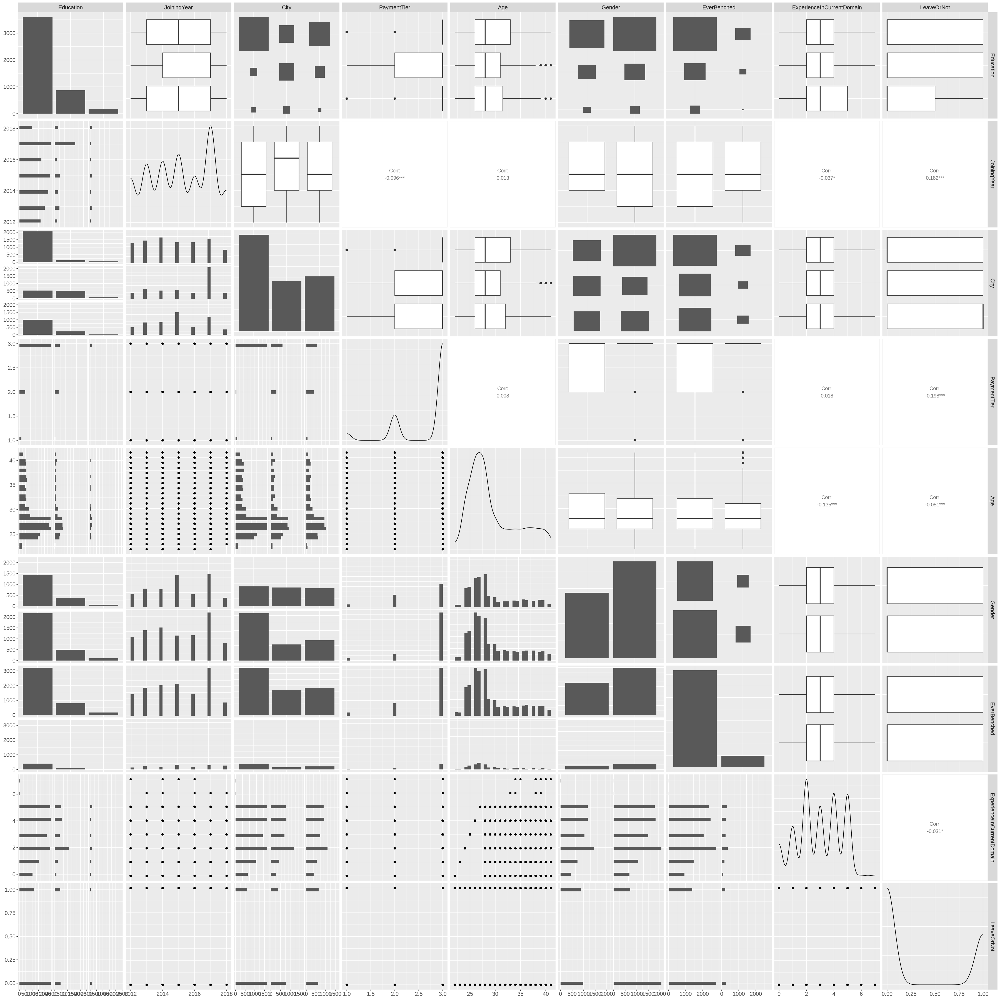

In [6]:
#we will first see
options(repr.plot.width = 30, repr.plot.height = 30)

Employee_pair_plot <- Employee_df %>%
    ggpairs(progress = FALSE) +
    theme(
        text = element_text(size = 15),
        plot.title = element_text(face = "bold"),
        axis.title = element_text(face = "bold"))

Employee_pair_plot

From the above plots, we can figure out that most of the columns are somewhat right skewed

Warning message:
“Use of `Employee_long_num$variable` is discouraged.
ℹ Use `variable` instead.”
Warning message:
“Use of `Employee_long_cat$variable` is discouraged.
ℹ Use `variable` instead.”


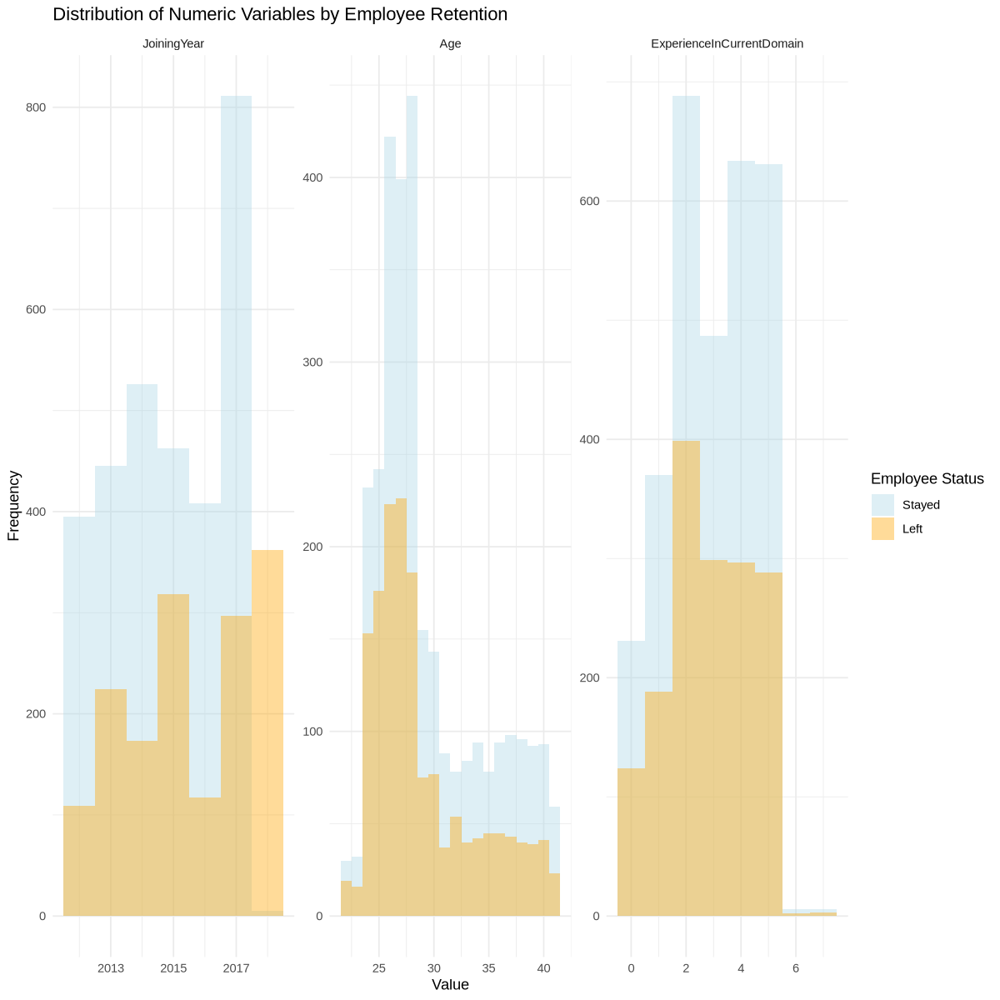

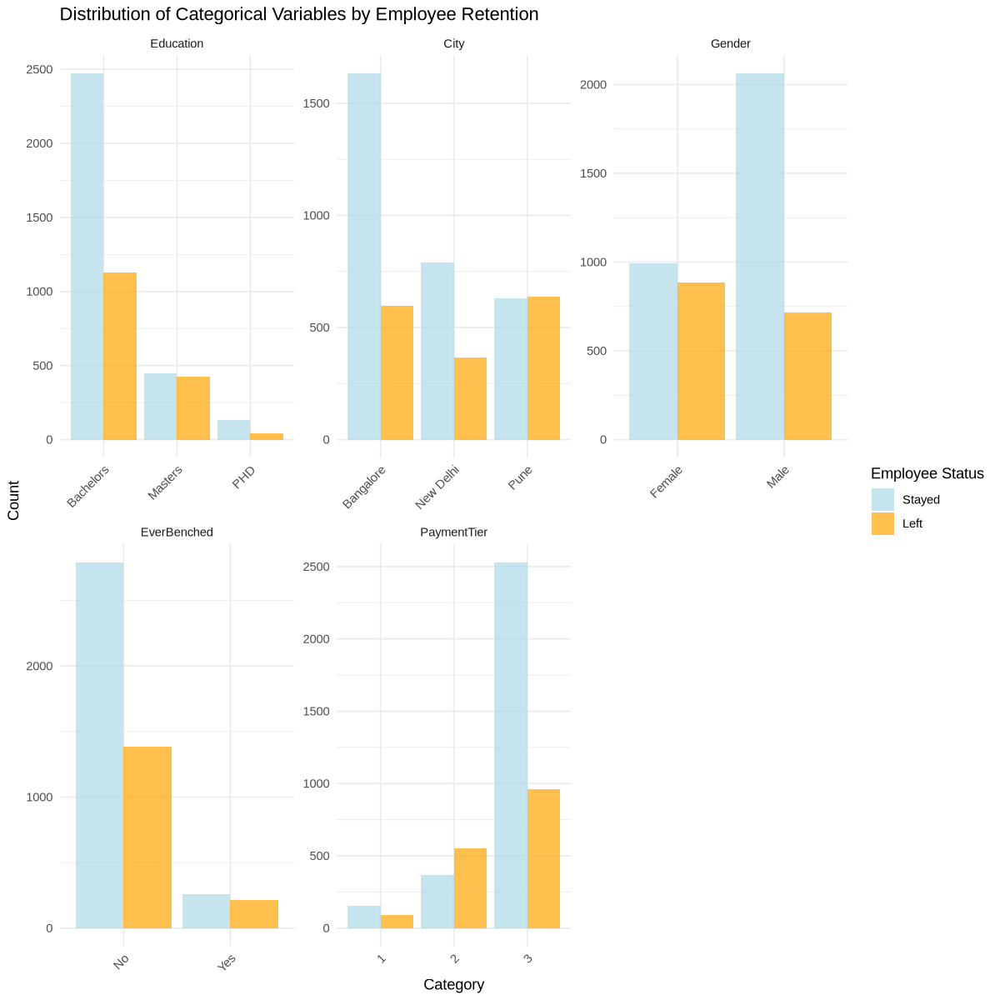

In [7]:
#next, we will zoom in on more detailed relationships between the columns and the target using overlapped box plots

options(repr.plot.width = 10, repr.plot.height = 10)
# Plot for numeric variables
p1 <- ggplot(Employee_long_num, aes(x = value, fill = factor(rep(Employee_df$LeaveOrNot, length(unique(Employee_long_num$variable)))))) +
  facet_wrap(~ variable, scales = "free") +
  geom_histogram(position = "identity", binwidth = 1, alpha = 0.4) + 
  theme_minimal() +
  labs(title = "Distribution of Numeric Variables by Employee Retention",
       x = "Value",
       y = "Frequency") +  # Changed y-axis label to Frequency
  scale_fill_manual(values = c("0" = "lightblue", "1" = "orange"),
                    labels = c("Stayed", "Left"),
                    name = "Employee Status")

# Plot for categorical variables stays the same
p2 <- ggplot(Employee_long_cat, aes(x = value, fill = factor(rep(Employee_df$LeaveOrNot, length(unique(Employee_long_cat$variable)))))) +
  facet_wrap(~ variable, scales = "free") +
  geom_bar(position = "dodge", alpha = 0.7) +
  theme_minimal() +
  theme(axis.text.x = element_text(angle = 45, hjust = 1)) +
  labs(title = "Distribution of Categorical Variables by Employee Retention",
       x = "Category",
       y = "Count") +
  scale_fill_manual(values = c("0" = "lightblue", "1" = "orange"),
                    labels = c("Stayed", "Left"),
                    name = "Employee Status")

# Display plots
p1
p2

we can see from this preliminary examination that there are some categories that are more linked to employee status than others, notably, Experience and age don't seem to have an effect, While Education, and payment tier have loose links, and finally, EverBenched, Gender, Location, and JoiningYear have some values which are extremely correlated with the employee leaving the company.

All in all from this exploratory analysis and visualization, we found that most of the data is right skewed, and that Experience and age are not good indicators, while Education and payment tier are okay indicators, and the rest are pretty solid indicators on whether an employee has left the company.

The next stage of the project would be to implement further algorithms, preprocess the data, decide on a model, and then finally train and refine the model so that it performs as hoped.

# Method and Plan stage (individual)

note: edit has been made in previous code due to feedback, notably moving payment tier from numerical to categorical

The question we are discussing is: What causes employees to want to leave the company, and how could we predict this accurately?

We will be using predictive modelling since we have access to past data and are tackling a classification problem. Additionally, due to the nature of the target being categorical rather than numerical, we will be using a logistic regressino model to complete this task.

We will be splitting the data into a 70:30 split between training and testing data for a simple yet effective balance between reliability and accuracy for our model.

We will also be using the random_state 123 for reproducibility of our solution.

There are several possible approahces to using logistic regression, for example GLM, Ridge and Lasso, however since our target column is a binary variable, and therefore it would be beneficial to go ahead with using GLM with the binomial family, which already assumes that the target is binary, which is true in our case. We also are not aware of any colinearity at this point, and therefore there is little to no benefit in using Ridge or Lasso at this point in time.

This however would be extremely vulnerable to any multicolinearity, and therefore we should confirm that there is little or no multicolinearity before moving forward with using GLM. An additional limitation would be the model's sensitivity to outliers, this is significantly more true when the sample size is small. However our dataset is about ~4600 rows long, and this should not be too much of an issue, last but not least, this assumes a linear decision boundary, and may not capture more complex interactions between variables, where other methods like random forests or gradient boosting methods may be more suitable. GLM also assumes a big enough dataset, which is already mentioned to be sufficient earlier.

If there is multicolinearity present, it would be more beneficial to go ahead with using Ridge since it would counteract multicolinearity while having little impact on our overall accuracy. We will not be using Lasso since it would effectively be removing predictors, potentially leading to a less stable and accurate model in our model with already limited amounts of columns.

The columns that we will be using will be finalized later during coding, however from our previous plots, we can see that JoiningYear, PaymentTier, Education, City, Gender and EverBenched have clear trends with whether the target is met, while Age and ExperienceInCurrentDomain seem to be uncorrelated with the target variable. We can perhaps replot the previous plots as proportions of each category rather than numbers to see the trends and decide whether to drop or not drop unneeded columns.

# Computation stage (individual)

Warning message:
“Use of `Employee_long_cat$variable` is discouraged.
ℹ Use `variable` instead.”


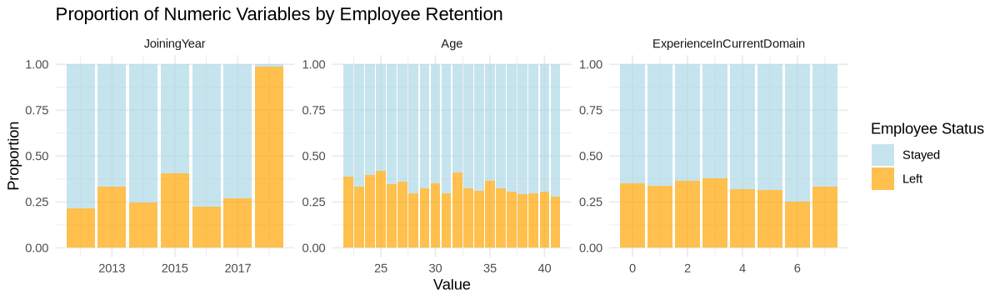

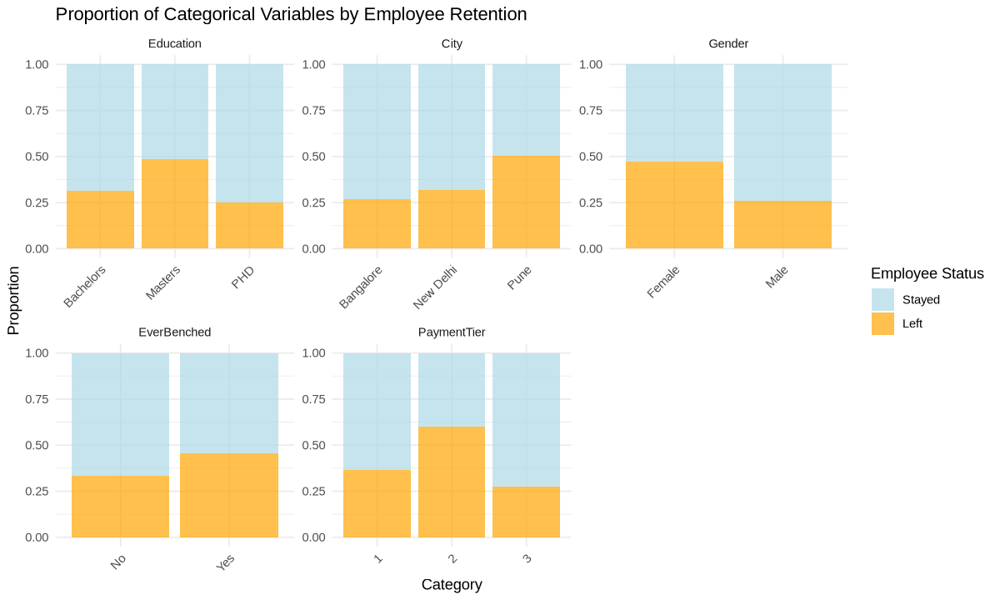

In [8]:
#we will first replot the correlation between each column and the target, this time the proportions for easier visualization
Employee_long_num$LeaveOrNot <- factor(rep(Employee_df$LeaveOrNot, length(unique(Employee_long_num$variable))))

Employee_long_num_prop <- Employee_long_num %>%
  group_by(variable, value, LeaveOrNot) %>%
  tally() %>%
  group_by(variable, value) %>%
  mutate(proportion = n / sum(n))  

p1 <- ggplot(Employee_long_num_prop, aes(x = value, y = proportion, fill = LeaveOrNot)) +
  facet_wrap(~ variable, scales = "free") +
  geom_bar(stat = "identity", position = "stack", alpha = 0.7) +  
  theme_minimal() +
  labs(title = "Proportion of Numeric Variables by Employee Retention",
       x = "Value",
       y = "Proportion") +
  scale_fill_manual(values = c("0" = "lightblue", "1" = "orange"),
                    labels = c("Stayed", "Left"),
                    name = "Employee Status")

p2 <- ggplot(Employee_long_cat, aes(x = value, fill = factor(rep(Employee_df$LeaveOrNot, length(unique(Employee_long_cat$variable)))))) +
  facet_wrap(~ variable, scales = "free") +
  geom_bar(position = "fill", alpha = 0.7) +
  theme_minimal() +
  theme(axis.text.x = element_text(angle = 45, hjust = 1)) +
  labs(title = "Proportion of Categorical Variables by Employee Retention",
       x = "Category",
       y = "Proportion") +
  scale_fill_manual(values = c("0" = "lightblue", "1" = "orange"),
                    labels = c("Stayed", "Left"),
                    name = "Employee Status")

options(repr.plot.width = 10, repr.plot.height = 3)
p1
options(repr.plot.width = 10, repr.plot.height = 6)
p2


We can see that our hypothesis in the methods and plan section was correct, that there is barely any variance between proportion of people who have stayed or left in age and experience, however there is still a barely visible trend of the proportion fo leaving personnel decreasing as the value increases, so maybe we should keep it for now.

We will now plot a correlation matrix to see whether there is multicolinearity.

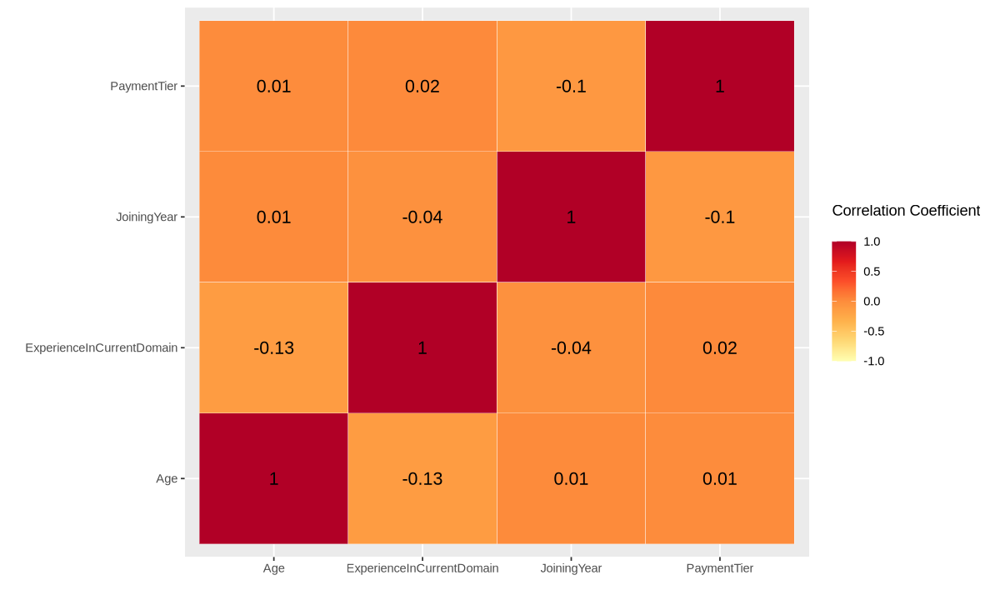

In [9]:
Employee_num <- Employee_df %>%
    select(-LeaveOrNot, -Education, -City, -Gender, -EverBenched)

corr_matrix <- 
    Employee_num %>%
    cor() %>%
    as_tibble(rownames = 'var1') %>%
    pivot_longer(-var1, names_to = "var2", values_to = "corr")

plot_corr_matrix <- 
    corr_matrix %>%
    ggplot(aes(var1, var2)) +
    geom_tile(aes(fill = corr), color = "white") +
    scale_fill_distiller("Correlation Coefficient \n",
                         palette = "YlOrRd",
                         direction = 1, 
                         limits = c(-1, 1)
    ) +
    labs(x = "", y = "") +
    geom_text(aes(var2, var1, label = round(corr, 2)), color = "black", size = 4.5)

plot_corr_matrix

We can see that there is no multicolinearity of concern within our numerical columns, the highest correlations are between age and experience however it is minimal and of no concern as far as multicolinearity goes, and therefore we will be going forward with using GLM as previously decided in our methods and plan section.

We will be generating 4 different models before coming to a conclusion on one good model, the models would be:
- utilizing all variables
- utilizing all minus the age variable
- utilizing all minus the experience variable
- utilizing all minus both age and experience variables.

This is to gauge whether the age and experience variable have any effect on the prediction model, and come to a final model with the highest accuracy of the 4.

## Implementation of a proposed model (glm of different models)

In [10]:
set.seed(123)

training <- Employee_df %>%
    sample_frac(0.7)

testing <- Employee_df %>%
    setdiff(training)

model_1 <- glm(LeaveOrNot ~ ., data = training, family = binomial)
model_2 <- glm(LeaveOrNot ~ . -Age, data = training, family = binomial)
model_3 <- glm(LeaveOrNot ~ . -ExperienceInCurrentDomain, data = training, family = binomial)
model_4 <- glm(LeaveOrNot ~ . -ExperienceInCurrentDomain -Age, data = training, family = binomial)

In [11]:
predictions_1 <- predict(model_1, newdata = testing, type = "response")
predictions_2 <- predict(model_2, newdata = testing, type = "response")
predictions_3 <- predict(model_3, newdata = testing, type = "response")
predictions_4 <- predict(model_4, newdata = testing, type = "response")

Type 'citation("pROC")' for a citation.


Attaching package: ‘pROC’


The following objects are masked from ‘package:stats’:

    cov, smooth, var


Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases



Area under the curve: 0.7047

Area under the curve: 0.7035

Area under the curve: 0.7041

Area under the curve: 0.7024

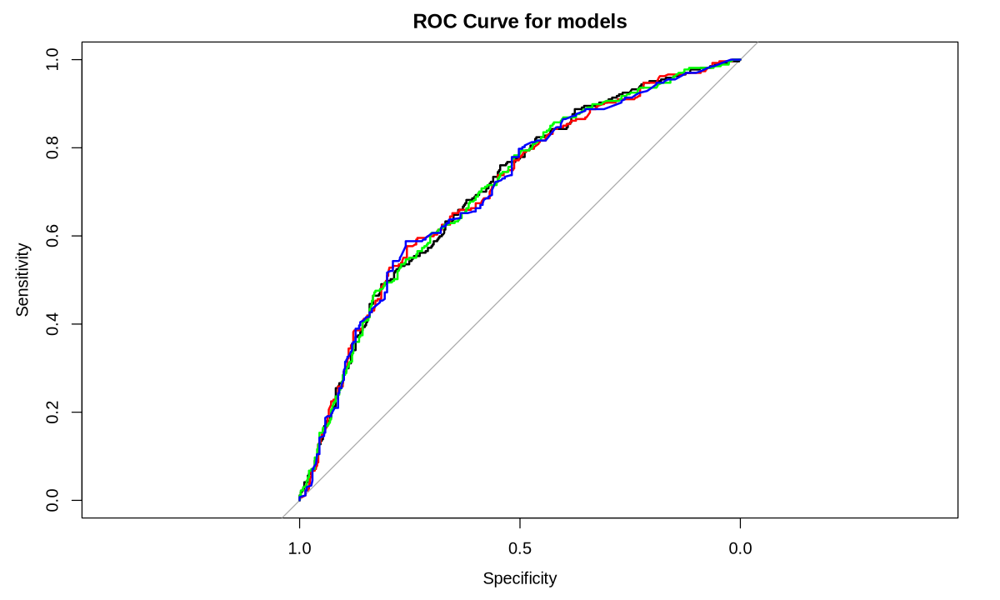

In [12]:
library(pROC)

roc_1 <- roc(testing$LeaveOrNot, predictions_1)
roc_2 <- roc(testing$LeaveOrNot, predictions_2)
roc_3 <- roc(testing$LeaveOrNot, predictions_3)
roc_4 <- roc(testing$LeaveOrNot, predictions_4)

plot(roc_1, main = "ROC Curve for models")
plot(roc_2, add = TRUE, col = "red")
plot(roc_3, add = TRUE, col = "green")
plot(roc_4, add = TRUE, col = "blue")

auc(roc_1)
auc(roc_2)
auc(roc_3)
auc(roc_4)

The best model is clearly the first model, it has the highest AUC, and we can see on the curve (model 1 is the black curve) that it is the most consistently close to the top left corner. However, an AUC of 0.7047 could definitely be improved on, and feature engineering may be done to improve this score. 

This is expected since these are just simple general logistic models without any feature engineering or filtering, and although the score could be improved on, it is most definitely not bad.

The next step may be testing this glm against a feature engineered version, or even a multiple logistic regression model since we are using a multitude of variables for this model.